<h1><p style="color:#00509D"> 🖥 The Project:</p><br><br><em>Songs classification into genre with Machine Learning</em></h1>
<br>
<br>
<h1><p style="color:#00509D"> 🦾 The Team : </p><br>
<img src="https://cdn.glitch.global/bc48e889-ef10-4a55-890c-334fcdd555e7/The%20Team.png?v=1655295454435">

<h3> ❓ Problem Definition:</h3>

*Welcome to our Machine Learning Music Genre Classification with several ML techniques. Our task is to use machine learning to classify audio tracks into genres.* 



<h3> ✅ Context: </h3>

Using machine learning to classify music, we are taking many features into account, with the motive to predict a target feature (genre). 
<br>Our data consists of the following features:

1 - track_id: Song unique ID

2 - track_name: Song Name 

3 - track_artist: Song Artist

4 - track_popularity: Song Popularity (0-100) where higher is better

5 - playlist_name: Name of playlist

6 - playlist_id: Playlist ID

7 - genre:Genre of track

8 - danceability: Danceability describes how suitable a track is for dancing based on a combination of musical elements including tempo, rhythm stability, beat strength, and overall regularity. A value of 0.0 is least danceable and 1.0 is most danceable.

9 - energy: Energy is a measure from 0.0 to 1.0 and represents a perceptual measure of intensity and activity. Typically, energetic tracks feel fast, loud, and noisy. For example, death metal has high energy, while a Bach prelude scores low on the scale. Perceptual features contributing to this attribute include dynamic range, perceived loudness, timbre, onset rate, and general entropy.

10 - key: The estimated overall key of the track. Integers map to pitches using standard Pitch Class notation . E.g. 0 = C, 1 = C♯/D♭, 2 = D, and so on. If no key was detected, the value is -1.

11 - loudness: The overall loudness of a track in decibels (dB). Loudness values are averaged across the entire track and are useful for comparing relative loudness of tracks. Loudness is the quality of a sound that is the primary psychological correlate of physical strength (amplitude). Values typical range between -60 and 0 db.

12 - mode: Mode indicates the modality (major or minor) of a track, the type of scale from which its melodic content is derived. Major is represented by 1 and minor is 0.
 
13 - speechiness: Speechiness detects the presence of spoken words in a track. The more exclusively speech-like the recording (e.g. talk show, audio book, poetry), the closer to 1.0 the attribute value. Values above 0.66 describe tracks that are probably made entirely of spoken words. Values between 0.33 and 0.66 describe tracks that may contain both music and speech, either in sections or layered, including such cases as rap music. Values below 0.33 most likely represent music and other non-speech-like tracks.

14 - acousticness: A confidence measure from 0.0 to 1.0 of whether the track is acoustic. 1.0 represents high confidence the track is acoustic.

15 - instrumentalness: Predicts whether a track contains no vocals. “Ooh” and “aah” sounds are treated as instrumental in this context. Rap or spoken word tracks are clearly “vocal”. The closer the instrumentalness value is to 1.0, the greater likelihood the track contains no vocal content. Values above 0.5 are intended to represent instrumental tracks, but confidence is higher as the value approaches 1.0.

16 - liveness: Detects the presence of an audience in the recording. Higher liveness values represent an increased probability that the track was performed live. A value above 0.8 provides strong likelihood that the track is live.

17 - valence: A measure from 0.0 to 1.0 describing the musical positiveness conveyed by a track. Tracks with high valence sound more positive (e.g. happy, cheerful, euphoric), while tracks with low valence sound more negative (e.g. sad, depressed, angry).

18 - tempo: The overall estimated tempo of a track in beats per minute (BPM). In musical terminology, tempo is the speed or pace of a given piece and derives directly from the average beat duration.

19 - duration_ms: Duration of song in milliseconds

<h3>🥇 Approach:</h3>

<b>Goal: </b> We will train a machine learning model to classify audio tracks into genres. We will used historic Data from the songs dataset and use the genre feature as our target.
<br><b>Target :</b> Genres. There are 6 classes (labels) of genre to predict.
<br><b>Steps :</b>

  I. Data Extraction: import data & perform initial high level analysis (EDA): number of columns, rows, missing values...

 II. Data Cleaning: deal with missing values, duplicate values...

 III. Feature Engineering: encode the categorical features.

 IV. Model Training: use ML models to classify genre.

 V. Performance Evaluation: determine which ML technique performs this classification best.

 VI. Conclusion

<h3>♥ Acknowledgements:</h3>

Helper functions used in data cleaning and feature engineering taken from Sarah HAQ github: <a href="https://github.com/shaq31415926/tub_advanced_ds"> shaq31415926</a>

<h3> Setup - Importing Libraries:</h3>

In [104]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
from pprint import pprint
import joblib

In [2]:
warnings.filterwarnings('ignore')

<h3> Loading the data & putting it in a variable called songs_data:</h3>

In [3]:
#Loading the data from a local files:

raw_data = pd.read_csv("../data/songs_data.csv")

# or you could also use the link : raw_data = pd.read_csv("https://bit.ly/songs_dataset")

# copy the raw_data to songs data to avoid the modification to raw_data directly

songs_data = raw_data.copy()

<h2> I. Exploratory Data Analysis:</h2>

![https://memegenerator.net/img/instances/56349520.jpg](https://memegenerator.net/img/instances/56349520.jpg)


In [4]:
#Let's visualize the 3 first rows of our data :

songs_data.head(3)

,track_id,track_name,track_artist,track_popularity,playlist_name,playlist_id,genre,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms
0,6f807x0ima9a1j3VPbc7VN,I Don't Care (with Justin Bieber) - Loud Luxur...,Ed Sheeran,66,Pop Remix,37i9dQZF1DXcZDD7cfEKhW,pop,0.748,0.916,6,-2.634,1,0.0583,0.1020,0.000000,0.0653,0.518,122.036,194754
1,0r7CVbZTWZgbTCYdfa2P31,Memories - Dillon Francis Remix,Maroon 5,67,Pop Remix,37i9dQZF1DXcZDD7cfEKhW,pop,0.726,0.815,11,-4.969,1,0.0373,0.0724,0.004210,0.3570,0.693,99.972,162600
2,1z1Hg7Vb0AhHDiEmnDE79l,All the Time - Don Diablo Remix,Zara Larsson,70,Pop Remix,37i9dQZF1DXcZDD7cfEKhW,pop,0.675,0.931,1,-3.432,0,0.0742,0.0794,0.000023,0.1100,0.613,124.008,176616


In [5]:
#Shape of our data:

songs_data.shape

(32833, 19)

In [6]:
songs_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32833 entries, 0 to 32832
Data columns (total 19 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   track_id          32833 non-null  object 
 1   track_name        32828 non-null  object 
 2   track_artist      32828 non-null  object 
 3   track_popularity  32833 non-null  int64  
 4   playlist_name     32833 non-null  object 
 5   playlist_id       32833 non-null  object 
 6   genre             32833 non-null  object 
 7   danceability      32833 non-null  float64
 8   energy            32833 non-null  float64
 9   key               32833 non-null  int64  
 10  loudness          32833 non-null  float64
 11  mode              32833 non-null  int64  
 12  speechiness       32833 non-null  float64
 13  acousticness      32833 non-null  float64
 14  instrumentalness  32833 non-null  float64
 15  liveness          32833 non-null  float64
 16  valence           32833 non-null  float6

⏩  The dataset has 19 columns and 32833 entries and has some null values in track_artist & track_name.

⏩  It has also 11 numerical attributes (9 float64 and 4 int64) and 6 objects

Let's list all non-numerical columns:

In [7]:
categorical_columns = list(songs_data.select_dtypes(['object']).columns)
categorical_columns

['track_id',
 'track_name',
 'track_artist',
 'playlist_name',
 'playlist_id',
 'genre']

### Identify the missing values:

In [8]:
songs_data.isnull().sum()

track_id            0
track_name          5
track_artist        5
track_popularity    0
playlist_name       0
playlist_id         0
genre               0
danceability        0
energy              0
key                 0
loudness            0
mode                0
speechiness         0
acousticness        0
instrumentalness    0
liveness            0
valence             0
tempo               0
duration_ms         0
dtype: int64

⏩ Using identify_missing_data function to get the percentage of missing data for every feature:

In [9]:
def identify_missing_data(df):
    
    percent_missing = df.isnull().mean()
    
    missing_value_df = pd.DataFrame(percent_missing).reset_index() # convert to DataFrame
    missing_value_df = missing_value_df.rename(columns = {"index" : "feature",
                                                                0 : "percent_missing"}) # rename columns

    missing_value_df = missing_value_df.sort_values(by = ['percent_missing'], ascending = False) # sort the values
    
    data_types_df = pd.DataFrame(df.dtypes).reset_index().rename(columns = {"index" : "feature",
                                                                0 : "data_type"}) # rename columns
    
    missing_value_df = missing_value_df.merge(data_types_df, on = "feature") # join the dataframe with datatype
    
    missing_value_df.percent_missing = round(missing_value_df.percent_missing*100, 2) # format the percent_missing
    
    return missing_value_df

In [10]:
missing_value_df = identify_missing_data(songs_data)
missing_value_df[missing_value_df['percent_missing']>0]

,feature,percent_missing,data_type
0,track_artist,0.02,object
1,track_name,0.02,object


In [11]:
#Let's figure out which entries are missing :

songs_data.loc[(songs_data.track_name.isna()) | (songs_data.track_artist.isna())]

,track_id,track_name,track_artist,track_popularity,playlist_name,playlist_id,genre,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms
8151,69gRFGOWY9OMpFJgFol1u0,NaN,NaN,0,HIP&HOP,5DyJsJZOpMJh34WvUrQzMV,rap,0.714,0.821,6,-7.635,1,0.1760,0.0410,0.00000,0.1160,0.649,95.999,282707
9282,5cjecvX0CmC9gK0Laf5EMQ,NaN,NaN,0,GANGSTA Rap,5GA8GDo7RQC3JEanT81B3g,rap,0.678,0.659,11,-5.364,0,0.3190,0.0534,0.00000,0.5530,0.191,146.153,202235
9283,5TTzhRSWQS4Yu8xTgAuq6D,NaN,NaN,0,GANGSTA Rap,5GA8GDo7RQC3JEanT81B3g,rap,0.465,0.820,10,-5.907,0,0.3070,0.0963,0.00000,0.0888,0.505,86.839,206465
19568,3VKFip3OdAvv4OfNTgFWeQ,NaN,NaN,0,Reggaeton viejito🔥,0si5tw70PIgPkY1Eva6V8f,latin,0.675,0.919,11,-6.075,0,0.0366,0.0606,0.00653,0.1030,0.726,97.017,252773
19811,69gRFGOWY9OMpFJgFol1u0,NaN,NaN,0,latin hip hop,3nH8aytdqNeRbcRCg3dw9q,latin,0.714,0.821,6,-7.635,1,0.1760,0.0410,0.00000,0.1160,0.649,95.999,282707


⏩ There are 10 missing values, 5 in track_name and 5 in track_artist; but there are only **5 rows with missing data**.

⏩ These rows are incomplete and useless. **We will drop them.**

### Identify duplicated data:

In [12]:
#Let's see the number of unique track_ids and identify if there is any duplicated data :

print("# unique track IDs :", len(songs_data.track_id.unique()))

# unique track IDs : 28356


In [13]:
#Identifying duplicated data:

songs_data[songs_data.duplicated(keep=False)]

,track_id,track_name,track_artist,track_popularity,playlist_name,playlist_id,genre,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms
12900,5dIgg4mrQHOlVm1ZFYHW29,Smoke on the Water,Deep Purple,44,"Classic Rock 70s 80s 90s, Rock Classics - 70s ...",3Ho3iO0iJykgEQNbjB2sic,rock,0.608,0.688,5,-7.655,0,0.0296,0.134000,0.206000,0.0951,0.749,114.414,334240
12901,0oWHLtxWeMJhmwxtrxhNK0,Welcome To The Jungle,Guns N' Roses,1,"Classic Rock 70s 80s 90s, Rock Classics - 70s ...",3Ho3iO0iJykgEQNbjB2sic,rock,0.443,0.955,8,-8.066,1,0.0741,0.022200,0.361000,0.2970,0.333,123.423,273600
12902,48C69MxPGtl8Yk49ruZvIU,Ozone,New Politics,47,"Classic Rock 70s 80s 90s, Rock Classics - 70s ...",3Ho3iO0iJykgEQNbjB2sic,rock,0.594,0.866,9,-4.741,0,0.0828,0.031500,0.000586,0.0800,0.856,160.025,172221
12903,3EZEk457H0jGFXajWbk67G,Thirteen,Vivillain,35,"Classic Rock 70s 80s 90s, Rock Classics - 70s ...",3Ho3iO0iJykgEQNbjB2sic,rock,0.595,0.929,8,-6.480,1,0.0419,0.000148,0.158000,0.3340,0.493,92.508,162900
12904,2G2WsFEP8lqYr8vg1mPtyI,Fake,RedHook,47,"Classic Rock 70s 80s 90s, Rock Classics - 70s ...",3Ho3iO0iJykgEQNbjB2sic,rock,0.607,0.962,1,-3.072,1,0.0575,0.001240,0.000005,0.1390,0.795,120.055,181271
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31118,5zBfEZ36QRKjkU0eqNuM8d,Hit It! - Original Extended Mix,Sidney Housen,4,Fitness Workout Electro | House | Dance | Prog...,6KnQDwp0syvhfHOR4lWP7x,edm,0.604,0.656,7,-6.703,1,0.0480,0.013800,0.051600,0.0794,0.198,129.982,373385
31119,5wQeCrJTJxGZnILnyCBHjI,Lovers on the Sun (feat. Sam Martin),David Guetta,54,Fitness Workout Electro | House | Dance | Prog...,6KnQDwp0syvhfHOR4lWP7x,edm,0.645,0.891,6,-2.505,0,0.0387,0.093200,0.000004,0.3790,0.568,124.915,203520
31120,280ZN1ZklTE91imtyQwMBa,Got it Like That - Edit,Syndicate Of L.A.W.,0,Fitness Workout Electro | House | Dance | Prog...,6KnQDwp0syvhfHOR4lWP7x,edm,0.460,0.961,0,-2.522,0,0.1470,0.023200,0.000002,0.3570,0.509,129.931,186444
31121,5fp6j7TdmXpmKM6QEDL6ZA,Faded,Afrojack,0,Fitness Workout Electro | House | Dance | Prog...,6KnQDwp0syvhfHOR4lWP7x,edm,0.621,0.924,7,-5.160,1,0.0448,0.006350,0.797000,0.1870,0.640,127.916,188134


In [14]:
#Let's print the number of duplicated rows which need to be dropped during the data cleaning :

print("# of duplicated rows to be dropped during data cleaning :", len(songs_data.loc[songs_data.duplicated()]))

# of duplicated rows to be dropped during data cleaning : 323


In [15]:
# let check one of our member fav song Welcome To The Jungle to see the duplicated row

songs_data[songs_data.track_name == "Welcome To The Jungle"]

,track_id,track_name,track_artist,track_popularity,playlist_name,playlist_id,genre,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms
3627,0bVtevEgtDIeRjCJbK3Lmv,Welcome To The Jungle,Guns N' Roses,78,80's Songs | Top 💯 80s Music Hits,65HtIbyFkaQPflCa4oW8KO,pop,0.446,0.954,8,-8.069,1,0.0764,0.0232,0.395,0.297,0.332,123.450,272027
11255,0bVtevEgtDIeRjCJbK3Lmv,Welcome To The Jungle,Guns N' Roses,78,This Is Guns N' Roses,37i9dQZF1DX74DnfGTwugU,rock,0.446,0.954,8,-8.069,1,0.0764,0.0232,0.395,0.297,0.332,123.450,272027
12366,0eFvoRSTTaR2q8bSWVjwfp,Welcome To The Jungle,Guns N' Roses,14,Rock Classics,37i9dQZF1DWXRqgorJj26U,rock,0.456,0.978,10,-4.869,0,0.1120,0.0301,0.499,0.313,0.327,123.411,271867
12594,5NIPsWpDjJTFBoPxCUUeXp,Welcome To The Jungle,Guns N' Roses,19,Classic Rock Workout,37i9dQZF1DWYNSm3Z3MxiM,rock,0.445,0.955,8,-8.027,1,0.0856,0.0326,0.284,0.317,0.336,123.343,273600
12901,0oWHLtxWeMJhmwxtrxhNK0,Welcome To The Jungle,Guns N' Roses,1,"Classic Rock 70s 80s 90s, Rock Classics - 70s ...",3Ho3iO0iJykgEQNbjB2sic,rock,0.443,0.955,8,-8.066,1,0.0741,0.0222,0.361,0.297,0.333,123.423,273600
13263,0bVtevEgtDIeRjCJbK3Lmv,Welcome To The Jungle,Guns N' Roses,78,Workday: Rock Classics,37i9dQZF1DX1lwxXvReaux,rock,0.446,0.954,8,-8.069,1,0.0764,0.0232,0.395,0.297,0.332,123.450,272027
14927,5NIPsWpDjJTFBoPxCUUeXp,Welcome To The Jungle,Guns N' Roses,19,’80s Hard Rock,37i9dQZF1DX68H8ZujdnN7,rock,0.445,0.955,8,-8.027,1,0.0856,0.0326,0.284,0.317,0.336,123.343,273600
15158,0oWHLtxWeMJhmwxtrxhNK0,Welcome To The Jungle,Guns N' Roses,1,"Classic Rock 70s 80s 90s, Rock Classics - 70s ...",3Ho3iO0iJykgEQNbjB2sic,rock,0.443,0.955,8,-8.066,1,0.0741,0.0222,0.361,0.297,0.333,123.423,273600
15677,1dM25yro2mjIAO5D1SvFDr,Welcome To The Jungle,Guns N' Roses,0,Classic Hard Rock,1gAeQGQ7hr2q7IYmaejDW6,rock,0.438,0.980,8,-4.963,1,0.1020,0.0258,0.462,0.279,0.326,123.407,271867
16155,0bVtevEgtDIeRjCJbK3Lmv,Welcome To The Jungle,Guns N' Roses,78,Hard Rock Classics 1967-1991 (Party Edition),1NIX36ZFWEtgXSbSNghoue,rock,0.446,0.954,8,-8.069,1,0.0764,0.0232,0.395,0.297,0.332,123.450,272027


We can see that there are some data quality issues and some of part of our data is mislabeled.

In [16]:
#Let's visualize if there is some data which has been mislabeled (target = genre) due to a human classficiation error ) :

mis_labeling = songs_data.groupby(['track_name', 'track_id'])['genre'].nunique()
mis_labeling = mis_labeling[mis_labeling > 1].sort_values(ascending= False)
mis_labeling

track_name                          track_id              
Falling                             4TnjEaWOeW0eKTKIEvJyCa    5
Ayy Macarena                        6LcauUZjF1eXQrgqMUecHX    5
Fantasias                           6mAN61JH0dzyZpWslS11jy    5
Tusa                                7k4t7uLgtOxPwTpFmtJNTY    5
HIGHEST IN THE ROOM                 3eekarcy7kvN4yt5ZFzltW    5
                                                             ..
Hot                                 00WIXhVVhswHuS6dlkScuw    2
Hopeless Romantic (feat. Swae Lee)  7IBSffWIu7P2MC7kMwy2FM    2
Hop Off A Jet (feat. Travis Scott)  3RZftiuTcLOqpsd8ZlwNhr    2
Hookah                              4piZ5m1vZGDkfyHga5U97m    2
男と女                                 1f76rJMP93OCXuDn3lzq0S    2
Name: genre, Length: 1686, dtype: int64

Let's visualise the level of mislabeled data:

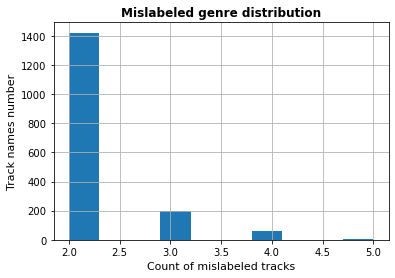

In [17]:
mis_labeling.hist()
plt.title('Mislabeled genre distribution', size=12, weight='bold')
plt.xlabel("Count of mislabeled tracks", size=11)
plt.ylabel('Track names number', size=11)
plt.show()

In [18]:
print(f"There are {round(mis_labeling[mis_labeling > 2].__len__() / songs_data.__len__() * 100, 2)}% of songs with more than 2 genres.")

There are 0.81% of songs with more than 2 genres.


⏩ So most multi-labeled tracks have 2 genres, and 0.81% of tracks have more than 2 genres. We will deal with them in the data cleaning section.

❗ We notice that for the same track_name, we have different unique track_id, but also multiple genres (labels), which we will take into consideration in our ML model.

### Identify the highly correlated features:

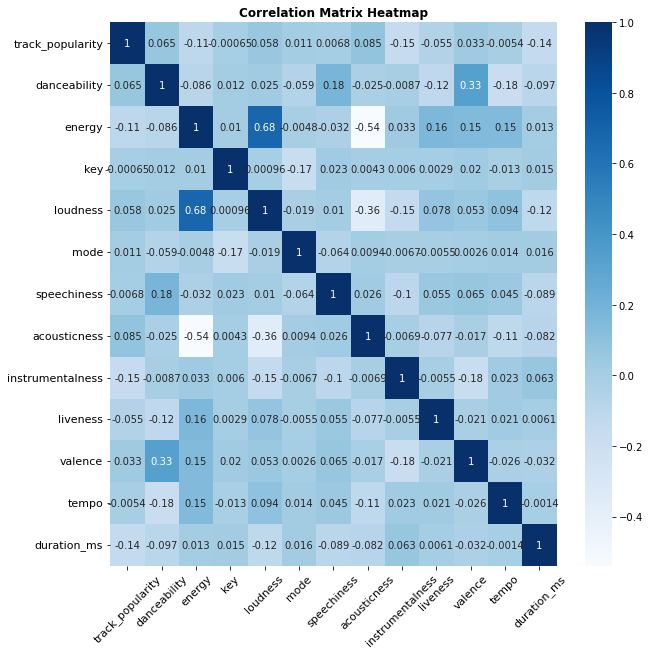

In [19]:
#Visualizing the correlation matrix between the numerical features:

corr_matrix = songs_data.corr()
fig = plt.figure(figsize = (10,10))
sns.heatmap(corr_matrix, cmap = "Blues", annot = True)
plt.xticks(rotation=45, size=11) 
plt.yticks(size=11)
plt.title("Correlation Matrix Heatmap", weight = "bold", size= 12)
plt.show()

Using identify_highly_correlated_features function to get a dataframe with highly correlated features:

In [20]:
def identify_highly_correlated_features(df, correlation_threshold):
    
    corr_matrix = df.corr().abs() # calculate the correlation matrix with 
    high_corr_var = np.where(corr_matrix >= correlation_threshold) # identify variables that have correlations above defined threshold
    high_corr_var = [(corr_matrix.index[x], corr_matrix.columns[y], round(corr_matrix.iloc[x, y], 2))
                         for x, y in zip(*high_corr_var) if x != y and x < y] # identify pairs of highly correlated variables
    
    high_corr_var_df = pd.DataFrame(high_corr_var).rename(columns = {0: 'corr_feature',
                                                                     1: 'drop_feature',
                                                                     2: 'corrrelation_values'})

    return high_corr_var_df.sort_values(by = 'corrrelation_values', ascending = False)

We define the threshhold to identify highly correlated features to 0.3 then we call the dataframe with the highly correlated features.

In [21]:
identify_highly_correlated_features(songs_data, correlation_threshold=0.3)

,corr_feature,drop_feature,corrrelation_values
1,energy,loudness,0.68
2,energy,acousticness,0.54
3,loudness,acousticness,0.36
0,danceability,valence,0.33


No features are correlated to each other higher than 0.7, which is our threshold to consider dropping highly correlated features. Thus, we will keep all features.

### Identify features with low variance:

Using identify_low_variance_features function to get a list of features that have low variance:

In [22]:
def identify_low_variance_features(df, std_threshold):
    
    std_df = pd.DataFrame(df.std()).rename(columns = {0: 'standard_deviation'})

    low_var_features = list(std_df[std_df['standard_deviation'] < std_threshold].index)

    print("number of low variance features:", len(low_var_features))
    print_low_var = print("low variance features:", low_var_features)
    
    return print_low_var

We define the threashold at 0.1, meaning that features with low variance have less than 10% of variance in the data.

In [23]:
identify_low_variance_features(songs_data, std_threshold=0.1) 

number of low variance features: 0
low variance features: []


We have not found any feature with low variance (threshold of 0.10) so we will not drop any feature.

### 📕 Report Overview: 

![https://media.makeameme.org/created/mind-blown-just.jpg](https://media.makeameme.org/created/mind-blown-just.jpg)







For the next code chunk, please scroll down for a report overview:

In [24]:
import pip

try:
    __import__("dataprep")
except ImportError:
    pip.main(['install', "dataprep"])

  0%|                                                  | 0/3064 [00:00<?, ?it/s]

My Report
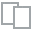
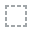
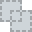
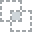
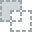
...
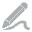
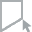
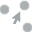
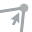
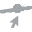

In [25]:
from dataprep.eda import create_report
report = create_report(songs_data, title='My Report')
report

### In-depth EDA of each genre

We want to see how the genres are different from each other and maybe see, what is unique for each genre.

In [26]:
# we have 6 genres in total

songs_data.genre.unique()

array(['pop', 'rap', 'rock', 'latin', 'r&b', 'edm'], dtype=object)

### Visualise the distribution of the target feature (genre):

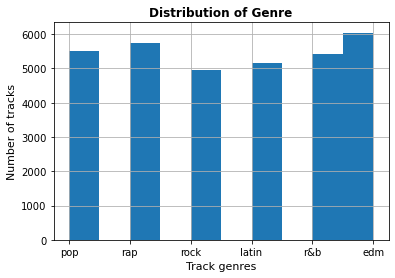

In [27]:
(songs_data.genre).hist()
plt.title("Distribution of Genre", size= 12, weight='bold')
plt.xlabel("Track genres", size=11)
plt.ylabel('Number of tracks', size=11)
plt.show()

The dataset is well balanced, with a similar distribution of tracks for each genre.

### ❗ We will be using classification algorithms since the genre values are classified to 6 values. Also, we notice that the the genre feature is balanced.

#### Track popularity

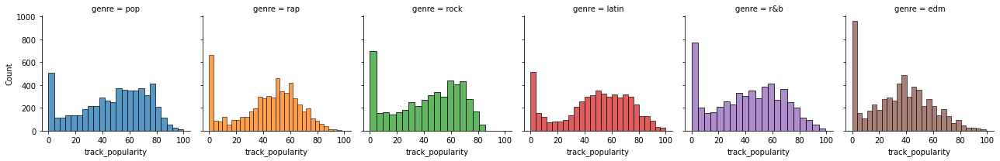

In [28]:
# What genre is more popular?
g = sns.FacetGrid(songs_data,  col="genre", hue="genre")
g.map_dataframe(sns.histplot, x="track_popularity");

In [29]:
# Checking the average popularity ranking of the tracks per genre

songs_data.groupby("genre").track_popularity.mean()

genre
edm      34.833526
latin    47.026576
pop      47.744870
r&b      41.223532
rap      43.215454
rock     41.728338
Name: track_popularity, dtype: float64

EDM has a particularly high number of songs that are not popular (not within the Top 100) and Rock has no songs that chart higher than Top 85. On average, Pop tracks are the most popular ones, followed by Latin and Rap tracks, that are often ranked in the Top 100. But generally, the distribution is quite similar across the genres.

#### Danceability

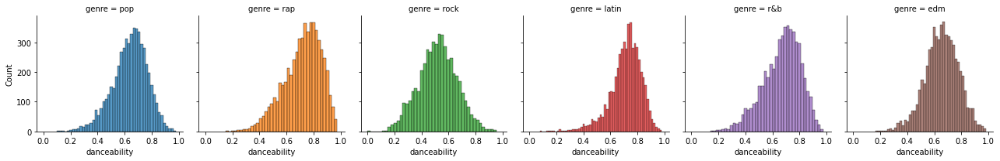

In [30]:
# What genre is best suitable for dancing?
g = sns.FacetGrid(songs_data,  col="genre", hue="genre")
g.map_dataframe(sns.histplot, x="danceability");

The rock genre can be considered relatively normally distributed while the other genres are more skewered to the right. That can mean that rock is considered less danceable to than the other genres. Rap, Latin and R&B appear to be the most popular genres as the most tracks of these genres are in a relatively high range.

#### Energy

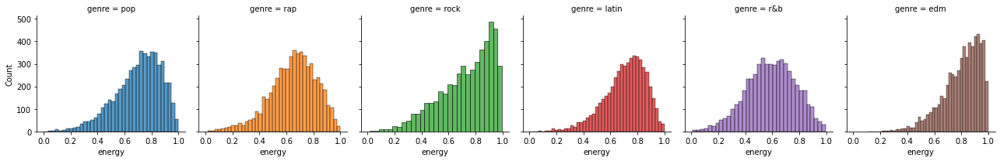

In [31]:
# What genre has the most energy?
g = sns.FacetGrid(songs_data,  col="genre", hue="genre")
g.map_dataframe(sns.histplot, x="energy");

The genres with the most energy are obviously Rock and EDM with a heaviliy skewered distribution to the right, meaning high energy levels. The other genres show very similar energy level distributions.

#### Key

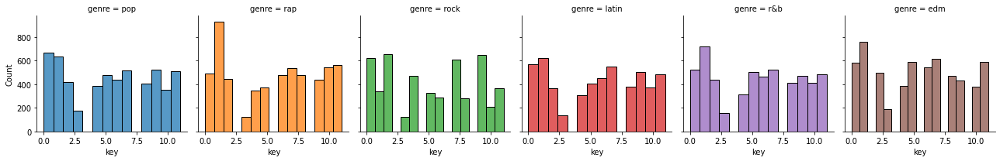

In [32]:
# What keys do the genres have?
g = sns.FacetGrid(songs_data,  col="genre", hue="genre")
g.map_dataframe(sns.histplot, x="key");

The genres show no specific differences between each other when it comes to the key. The only noticeable difference is the Rap genre which seems to have a particularly high number of tracks with the key C♯/D♭ (see the Data description in the introductoion part for more details), which is an interesting fact :)

#### Loudness

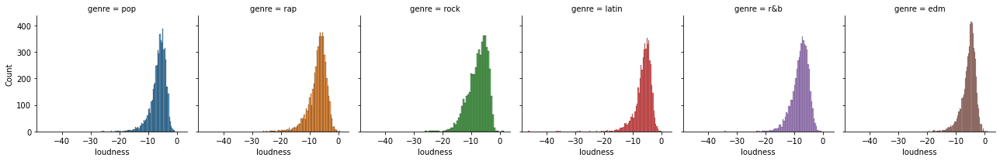

In [33]:
# What genre is loud?
g = sns.FacetGrid(songs_data,  col="genre", hue="genre")
g.map_dataframe(sns.histplot, x="loudness");

The loudness is very similar across genres. Only Rock shows a higher number of tracks in lower dB ranges, meaning Rock tracks are more loud typically. 

#### Mode

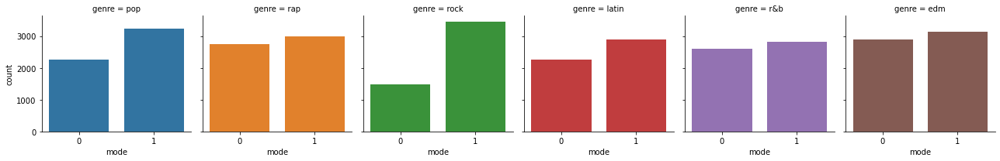

In [34]:
# What modes to the genres prefer to use?
g = sns.FacetGrid(songs_data,  col="genre", hue="genre")
g.map_dataframe(sns.countplot, x="mode");

A mode in major usually correlates to a more happy mood as the tone is brighter. The genres rock, pop and latin have more songs in major which could mean rock, pop and latin songs are happier and lighter. For the other genres the distribution is roughly the same. A minor mode sounds more sad and heavier to most people.

#### Speechiness

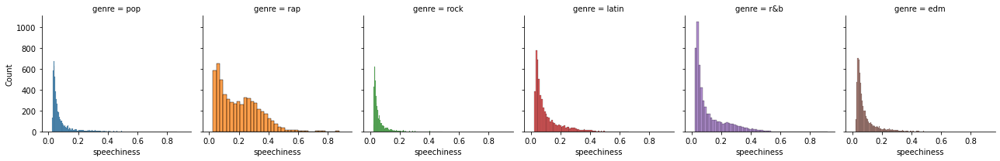

In [35]:
# Which genre uses the most words?
g = sns.FacetGrid(songs_data,  col="genre", hue="genre")
g.map_dataframe(sns.histplot, x="speechiness");

There is a noticeable difference with one of the genres. As expected, **Rap** has the highest speechiness levels among the genres due to its nature to contain more text and spoken words than the other genres. Rap has even some tracks above the value of 0.66 that can be considered almost only text and little music. The other genres' distributions are more between 0 and 0.33, showing that they contain more music and less words. Among them, R&B, Latin and EDM show slightly higher speechiness.

#### Acousticness

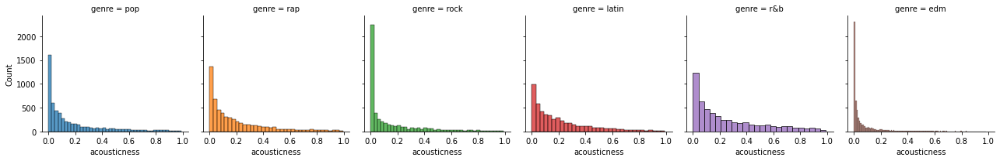

In [36]:
# What genre is more acoustic?
g = sns.FacetGrid(songs_data,  col="genre", hue="genre")
g.map_dataframe(sns.histplot, x="acousticness");

Acousticness refers to the usage of instruments in music and thus having little electronic sounds. The genres R&B, Rap and Latin show particularly high use of instruments in their tracks. Whereas EDM naturally has very little acousticness as the genre uses a lot of electronic means in their production. Overall the distribution appears very similar though.

#### Instrumentalness

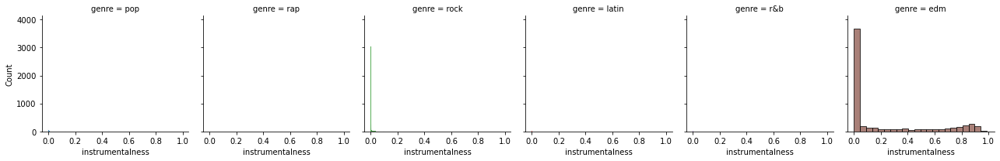

In [37]:
# What genre is more instrumental?
g = sns.FacetGrid(songs_data,  col="genre", hue="genre")
g.map_dataframe(sns.histplot, x="instrumentalness");

Instrumentalness means that a track contains no vocals. That is obviously the use for EDM music that typically can consist of only beats and no or very little spoken words. That is not the case for the other genres and is therefore a very distinct characteristic of EDM.

#### Liveness

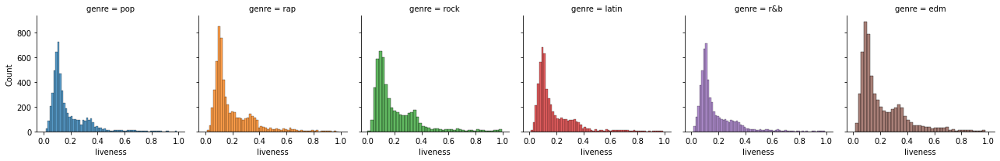

In [38]:
# What genre's tracks have been performed probably live?
g = sns.FacetGrid(songs_data,  col="genre", hue="genre")
g.map_dataframe(sns.histplot, x="liveness");

The distribution for liveness is almost the same for each genre with a left-side skeweredness. Among the genres, EDM and also rock show higher probability of the track version having been performed live and then published on the audio streaming platform.

#### Valence

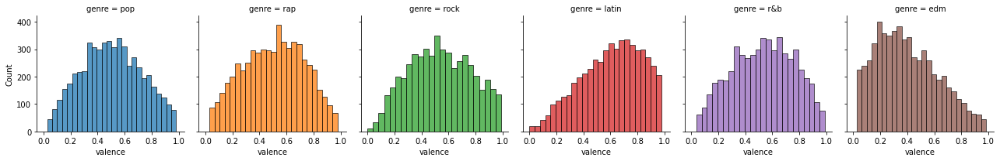

In [39]:
# What genre is happy?
g = sns.FacetGrid(songs_data,  col="genre", hue="genre")
g.map_dataframe(sns.histplot, x="valence");

The valence for the genres is roughly normally distributed. Only Latin tracks have higher valence, meanings they are majorly happy, whereas EDM tracks are majorly less happy from the sounds. The remaining genres have very similar distribution.

#### Tempo

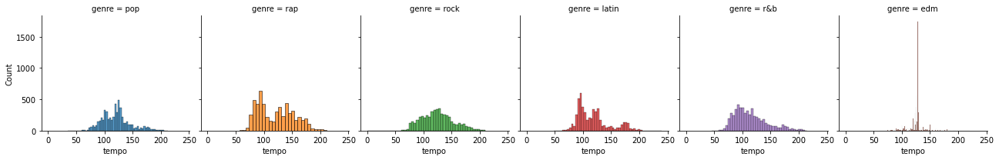

In [40]:
# How fast are the genres?
g = sns.FacetGrid(songs_data,  col="genre", hue="genre")
g.map_dataframe(sns.histplot, x="tempo");

The tempo is measured in BPM meaning beats per minute. The EDM genre distribution shows that most tracks are within the same range of around 130 BMP. The other genres show more variation when it comes to the tempo. R&B and Latin music are generally slower on average. Rap music shows a twinpeak distribution, so songs are either in a lower range around 90 BPM or higher range around 130 BPM. Compared to other genres, they have a lot of songs with a low BPM. The Latin genre also has multiple peaks within its distribution. Both Pop and Rock have a similar tempo.

#### Duration

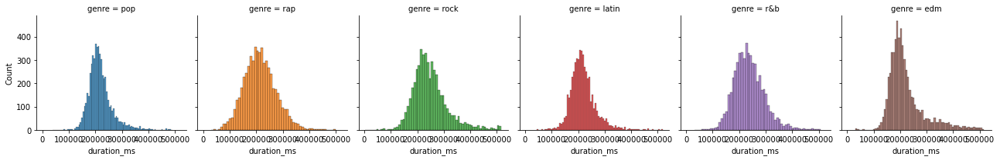

In [41]:
# How long are the tracks of the genres?
g = sns.FacetGrid(songs_data,  col="genre", hue="genre")
g.map_dataframe(sns.histplot, x="duration_ms");

The duration for all genres is roughly the same, showing no distinct difference across the genres.

#### Summary

As we could see from the analysis of each feature, most features appear actually quite similar across genres. That is especially the case for example for the duration, key, loudness, and danceability where none or only one genre stands out slightly. <em>This might make classification harder</em>. 

Below we will summarize some special characteristics that could be helpful for classification of one genre. We believe that EDM as well as Rap are more easy to predict, as they stand out more through some features. On the other side, Pop will be hard to predict because it has no distict feature (which makes sense as pop music is produced according to the general public, thus is mainstream). 

##### EDM

The EDM genre has the most tracks that are instrumental (contain no vocals). EDM tracks also tend to be generally less popular, have very high energy levels, are less acoustic, and show on average lower valence. Tracks are more likely to have been performed live and most of them have a similar tempo.

##### Rap

Rap genre tracks show particularly high speechiness. The other features are usually similar to more than one other genre. They are in the lower half when it comes to popularity of the genre and Rap shows slightly higher danceability and slightly higher acousticness. Rap songs tend to be either of a slow or fast tempo (see the twinpeak distribution).

##### Rock

Rock songs are characterized by a relatively low popularity. There are no popular rock songs. Rock has generally a low danceabilit but very high energy levels. They are also loud which so the usage of the major mode makes sense here. Rock tracks also have higher probability to be a live version. 

##### Latin

The Latin genre is the second to most popular genres and has slighlty higher danceability. Tracks of this genre appear to have slightly higher speechiness and slightly higher acousticness. The tempo shows greater variety than other genres with multiple peaks. The most prevalent feature is the valence, which appears to be higher than for other genres. Lastly, it makes slightly more usage of the major mode. 

##### R&B

R&B has in comparison to the other genres a slightly higher speechiness and has the most acousticness. R&B tracks are on average slower as well. But otherwise, it is not that easy to distinguish the genre. 

##### Pop

Pop songs are the most popular generally and make a lot of use of a major mode. For the remaining features the genre does not really stand out much. 

<h2> II. Data Cleaning:</h2>

![https://miro.medium.com/max/800/1*Xhm9c9qDfXa3ZCQjiOvm_w.jpeg](https://miro.medium.com/max/800/1*Xhm9c9qDfXa3ZCQjiOvm_w.jpeg)







### Drop rows with missing (null) values:

In [42]:
songs_data_cleaned =songs_data[~songs_data.track_name.isnull()] #we subset the dataframe, keeping only the tracks (rows) where the track_name is not null 
songs_data_cleaned.head(3) #we display the first 3 rows of the new cleaned dataframe

,track_id,track_name,track_artist,track_popularity,playlist_name,playlist_id,genre,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms
0,6f807x0ima9a1j3VPbc7VN,I Don't Care (with Justin Bieber) - Loud Luxur...,Ed Sheeran,66,Pop Remix,37i9dQZF1DXcZDD7cfEKhW,pop,0.748,0.916,6,-2.634,1,0.0583,0.1020,0.000000,0.0653,0.518,122.036,194754
1,0r7CVbZTWZgbTCYdfa2P31,Memories - Dillon Francis Remix,Maroon 5,67,Pop Remix,37i9dQZF1DXcZDD7cfEKhW,pop,0.726,0.815,11,-4.969,1,0.0373,0.0724,0.004210,0.3570,0.693,99.972,162600
2,1z1Hg7Vb0AhHDiEmnDE79l,All the Time - Don Diablo Remix,Zara Larsson,70,Pop Remix,37i9dQZF1DXcZDD7cfEKhW,pop,0.675,0.931,1,-3.432,0,0.0742,0.0794,0.000023,0.1100,0.613,124.008,176616


In [43]:
#we verify the new dataframe for missing (null values:

missing_value_df = identify_missing_data(songs_data_cleaned)
missing_value_df[missing_value_df['percent_missing']>0]

,feature,percent_missing,data_type


- Our dataset songs_data_cleaned does not contain anymore NAs. 
- As the missing values for track_name and track_artist correspond to the same rows, this was expected.

⏩ Let us now **drop track_id and playlist_id** : they contain too many categories and do not add any information to our ML model:

In [44]:
songs_data_cleaned = songs_data_cleaned.drop(["track_id","playlist_id"], axis=1) #axis=1 means dropping a column

In [45]:
songs_data_cleaned.shape

(32828, 17)

Checking for duplicates again:

In [46]:
songs_data_cleaned[songs_data_cleaned.duplicated(keep=False)]

,track_name,track_artist,track_popularity,playlist_name,genre,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms
12900,Smoke on the Water,Deep Purple,44,"Classic Rock 70s 80s 90s, Rock Classics - 70s ...",rock,0.608,0.688,5,-7.655,0,0.0296,0.134000,0.206000,0.0951,0.749,114.414,334240
12901,Welcome To The Jungle,Guns N' Roses,1,"Classic Rock 70s 80s 90s, Rock Classics - 70s ...",rock,0.443,0.955,8,-8.066,1,0.0741,0.022200,0.361000,0.2970,0.333,123.423,273600
12902,Ozone,New Politics,47,"Classic Rock 70s 80s 90s, Rock Classics - 70s ...",rock,0.594,0.866,9,-4.741,0,0.0828,0.031500,0.000586,0.0800,0.856,160.025,172221
12903,Thirteen,Vivillain,35,"Classic Rock 70s 80s 90s, Rock Classics - 70s ...",rock,0.595,0.929,8,-6.480,1,0.0419,0.000148,0.158000,0.3340,0.493,92.508,162900
12904,Fake,RedHook,47,"Classic Rock 70s 80s 90s, Rock Classics - 70s ...",rock,0.607,0.962,1,-3.072,1,0.0575,0.001240,0.000005,0.1390,0.795,120.055,181271
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31118,Hit It! - Original Extended Mix,Sidney Housen,4,Fitness Workout Electro | House | Dance | Prog...,edm,0.604,0.656,7,-6.703,1,0.0480,0.013800,0.051600,0.0794,0.198,129.982,373385
31119,Lovers on the Sun (feat. Sam Martin),David Guetta,54,Fitness Workout Electro | House | Dance | Prog...,edm,0.645,0.891,6,-2.505,0,0.0387,0.093200,0.000004,0.3790,0.568,124.915,203520
31120,Got it Like That - Edit,Syndicate Of L.A.W.,0,Fitness Workout Electro | House | Dance | Prog...,edm,0.460,0.961,0,-2.522,0,0.1470,0.023200,0.000002,0.3570,0.509,129.931,186444
31121,Faded,Afrojack,0,Fitness Workout Electro | House | Dance | Prog...,edm,0.621,0.924,7,-5.160,1,0.0448,0.006350,0.797000,0.1870,0.640,127.916,188134


In [47]:
#double checking if we have new track duplicates:

songs_testing_duplicates = songs_data_cleaned[songs_data_cleaned.duplicated(keep=False)]
songs_testing_duplicates.loc[songs_testing_duplicates['track_name'] == 'Rasputin - Radio Edit']

,track_name,track_artist,track_popularity,playlist_name,genre,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms
28057,Rasputin - Radio Edit,Hard Rock Sofa,0,Fitness Workout Electro | House | Dance | Prog...,edm,0.531,0.973,5,-1.87,1,0.0399,0.0346,0.709,0.203,0.13,127.98,170507
31122,Rasputin - Radio Edit,Hard Rock Sofa,0,Fitness Workout Electro | House | Dance | Prog...,edm,0.531,0.973,5,-1.87,1,0.0399,0.0346,0.709,0.203,0.13,127.98,170507


⏩ The track names are duplicates with exactly the same content so we decide to drop them.

In [48]:
#subsetting our dataset to delete duplicate tracks from our "cleaned" dataset:
print("# of the duplicated rows :", len(songs_data_cleaned[songs_data_cleaned.duplicated(keep=False)]))
print("songs dataset shape before cleaning :", songs_data_cleaned.shape)

# of the duplicated rows : 646
songs dataset shape before cleaning : (32828, 17)


In [49]:
#we drop the duplicates : 
idx_to_drop = list(songs_data_cleaned[songs_data_cleaned.duplicated(keep=False)].index)

ix=[i for i in songs_data_cleaned.index if i not in idx_to_drop]  
songs_data_cleaned = songs_data_cleaned.loc[ix]

#we display the shape of the new dataset:
print("new dataset shape after deleting the duplicates :", songs_data_cleaned.shape)
print("Showing the 3 first rows of the new dataset :")
songs_data_cleaned.head(3)

new dataset shape after deleting the duplicates : (32182, 17)
Showing the 3 first rows of the new dataset :


,track_name,track_artist,track_popularity,playlist_name,genre,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms
0,I Don't Care (with Justin Bieber) - Loud Luxur...,Ed Sheeran,66,Pop Remix,pop,0.748,0.916,6,-2.634,1,0.0583,0.1020,0.000000,0.0653,0.518,122.036,194754
1,Memories - Dillon Francis Remix,Maroon 5,67,Pop Remix,pop,0.726,0.815,11,-4.969,1,0.0373,0.0724,0.004210,0.3570,0.693,99.972,162600
2,All the Time - Don Diablo Remix,Zara Larsson,70,Pop Remix,pop,0.675,0.931,1,-3.432,0,0.0742,0.0794,0.000023,0.1100,0.613,124.008,176616


✔ **Features correlation summary and next steps :**

Do we have any highly correlated features (i.e. positive or negative correlation above 0.8)?

> NO!

Do we have any features with low variance?

> NO!

### ❗Data cleaning ends here

<h2> III. Feature Engineering:</h2>

Using identify_number_categories to get a dataframe with the categorical features and number of categories:

In [50]:
def identify_number_categories(df):

    categorical_columns = list(df.select_dtypes(['object']).columns)

    cat_df = []

    for c in categorical_columns:
        cat_df.append({"categorical_feature": c,
                       "number_categories": len(df[c].value_counts(dropna = False))
                    })
        
    return pd.DataFrame(cat_df).sort_values(by = "number_categories", ascending = False)

In [51]:
#Identifying the number of categories in our cleaned songs dataframe:

identify_number_categories(songs_data_cleaned)

,categorical_feature,number_categories
0,track_name,23311
1,track_artist,10615
2,playlist_name,449
3,genre,6


In [52]:
print(f"The Songs_data_cleaned dataframe has {len(identify_number_categories(songs_data_cleaned))} categorical features.")

The Songs_data_cleaned dataframe has 4 categorical features.


Let's look at the categorical features and their value counts:

In [53]:
#counting the number of categories for the track_name feature and the number of values by category ::

print(f"There are in total {len(songs_data_cleaned.track_name.unique())} categories for the track_name.\n")

print("Counting the number of values by category for track_name:")
print(songs_data_cleaned.track_name.value_counts())

There are in total 23311 categories for the track_name.

Counting the number of values by category for track_name:
Poison                    22
Breathe                   21
Forever                   20
Alive                     20
Stay                      19
                          ..
Aunque Ya No Estés         1
Dime Si Te Acuerdas        1
Pa Tu Casa                 1
Vuelva a Ver               1
Typhoon - Original Mix     1
Name: track_name, Length: 23311, dtype: int64


In [54]:
#counting the number of categories for the track_name feature and the number of values by category :

print(f"There are in total {len(songs_data_cleaned.playlist_name.unique())} categories for the playlist_name.\n")

print("Counting the number of values by category for playlist_name :")
print(songs_data_cleaned.playlist_name.value_counts())

There are in total 449 categories for the playlist_name.

Counting the number of values by category for playlist_name :
Indie Poptimism                                                                                  308
Permanent Wave                                                                                   244
Hard Rock Workout                                                                                219
Ultimate Indie Presents... Best Indie Tracks of the 2010s                                        198
Charts 2020 🔥Top 2020🔥Hits 2020🔥Summer 2020🔥Pop 2020🔥Popular Music🔥Clean Pop 2020🔥Sing Alongs    189
                                                                                                ... 
Big White Room-Jessie-J                                                                            7
TOP 50 GLOBAL 2020 UPDATED WEEKLY 🌍🎶 WORLDWIDE                                                     6
Fitness Workout Electro | House | Dance | Progressive House             

In [55]:
print("Shape of the Songs dataframe cleaned :", songs_data_cleaned.shape)

Shape of the Songs dataframe cleaned : (32182, 17)


⏩ We decided to drop track_name and playlist_name. The number of categories is insane, we think they are both irrelevant for our ML model. There is no need to encode them.

In [56]:
#dropping track_name and playlist_name:

songs_data_cleaned = songs_data_cleaned.drop(["track_name","playlist_name"], axis=1 ) 

In [57]:
print("Shape of the new songs dataframe :", songs_data_cleaned.shape)

Shape of the new songs dataframe : (32182, 15)


In [58]:
songs_data_cleaned.track_artist.value_counts()

Martin Garrix       157
Queen               134
The Chainsmokers    117
Don Omar            102
David Guetta        100
                   ... 
Sugarloaf             1
Jane Ashton           1
Generation X          1
Gordon Lightfoot      1
Mat Zo                1
Name: track_artist, Length: 10615, dtype: int64

⏩  For track_artist, we decided to take the top 20 trending artist from billboard.com/charts (week June 18,2022) and encode the track_artist using the top_20_artist below:

### Encode track_artist:

In [59]:
# Encoding the top 20 artist, using the top20 artists from billboard chart at the date of 14.06.2022 :
top_20_artist = ['Harry Styles', 'Post Mallone', 'Bad Bunny', 'Morgan Wallen', 'SEVENTEEN', 'Doja Cat', 'Kendrick Lamar', 'Ed Sheeran', 'Jack Harlow', 'The Weeknd', 'Future', 'Olivia Rodrigo', 'Drake', 'Luke Combs', 'Lil Baby', 'Kate Bush', 'Prince', 'Dua Lipa', 'Lizzo', 'Kanye West']

songs_data_cleaned['top_20'] = songs_data_cleaned['track_artist'].apply(lambda x: 1 if x in top_20_artist else 0) #creating a new column top_20 where value is 1 if the artist belongs to the top_20, 0 if else

songs_data_cleaned.drop(["track_artist"], axis=1, inplace=True) #dropping the track_artist column with categorical values (artist names)

### Encode the target feature: genre

In [60]:
# Import label encoder
from sklearn import preprocessing

# label_encoder object knows how to understand word labels.
label_encoder = preprocessing.LabelEncoder()
  
# Encode labels in column 'genre'.
songs_data_cleaned['genre']= label_encoder.fit_transform(songs_data_cleaned['genre'])
  
songs_data_cleaned['genre'].unique()


array([2, 4, 5, 1, 3, 0])

<b>Creating a dictionnary for the encoded genres</b>

In [61]:
#Code to map encoded labels: 
list_genres_encoded = [0, 1, 2, 3, 4, 5]
list_genres = label_encoder.inverse_transform(list_genres_encoded)

target_dict = {key: var for key, var in zip(list_genres_encoded, list_genres)} 

In [62]:
print("Dictionnary to map the encoded genres :")
target_dict

Dictionnary to map the encoded genres :


{0: 'edm', 1: 'latin', 2: 'pop', 3: 'r&b', 4: 'rap', 5: 'rock'}

In [63]:
songs_data_cleaned

,track_popularity,genre,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,top_20
0,66,2,0.748,0.916,6,-2.634,1,0.0583,0.102000,0.000000,0.0653,0.5180,122.036,194754,1
1,67,2,0.726,0.815,11,-4.969,1,0.0373,0.072400,0.004210,0.3570,0.6930,99.972,162600,0
2,70,2,0.675,0.931,1,-3.432,0,0.0742,0.079400,0.000023,0.1100,0.6130,124.008,176616,0
3,60,2,0.718,0.930,7,-3.778,1,0.1020,0.028700,0.000009,0.2040,0.2770,121.956,169093,0
4,69,2,0.650,0.833,1,-4.672,1,0.0359,0.080300,0.000000,0.0833,0.7250,123.976,189052,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32828,42,0,0.428,0.922,2,-1.814,1,0.0936,0.076600,0.000000,0.0668,0.2100,128.170,204375,0
32829,20,0,0.522,0.786,0,-4.462,1,0.0420,0.001710,0.004270,0.3750,0.4000,128.041,353120,0
32830,14,0,0.529,0.821,6,-4.899,0,0.0481,0.108000,0.000001,0.1500,0.4360,127.989,210112,0
32831,15,0,0.626,0.888,2,-3.361,1,0.1090,0.007920,0.127000,0.3430,0.3080,128.008,367432,0


In [64]:
songs_data_cleaned.shape

(32182, 15)

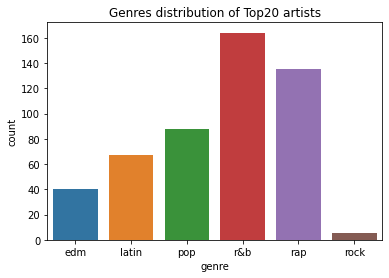

In [65]:
#representation of the 6 genres categories according to the top_20 artists :

sns.countplot(songs_data_cleaned.loc[songs_data_cleaned.top_20 ==1]['genre'])
plt.title("Genres distribution of Top20 artists")
plt.xticks(range(6),list_genres)
plt.xlabel('genre')
plt.show()

The top20 artists are not equally distributed between the genres, this could be an area of improvement for further analysis, according to the top20 artists feature importance while building our ML models.

<h2> IV. Machine Learning:</h2>

![https://memegenerator.net/img/instances/80627046.jpg](https://memegenerator.net/img/instances/80627046.jpg)

In [66]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.metrics import confusion_matrix
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, recall_score, precision_score, f1_score, confusion_matrix, classification_report

### Split the data into train and test sets:

In [67]:
#creating the target and the features to label the data and train the model :

target = songs_data_cleaned.genre
features = songs_data_cleaned.drop(['genre'], axis = 1)

In [68]:
print("Target shape :", target.shape)

Target shape : (32182,)


In [69]:
print("Features shape :", features.shape)

Features shape : (32182, 14)


We split the data into 80% training set and 20% test set:

In [70]:
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.2, random_state=42, stratify=target)

In [71]:
print("Training Data")
print("Shape of X_train", X_train.shape)
print("Shape of y_train", y_train.shape)

Training Data
Shape of X_train (25745, 14)
Shape of y_train (25745,)


In [72]:
print("Testing Data")
print("Shape of X_test", X_test.shape)
print("Shape of y_test", y_test.shape)

Testing Data
Shape of X_test (6437, 14)
Shape of y_test (6437,)


### Scale the training data:

The features have different scales and we will be working with a model sensitive to the distance (logistic regression) so we need to scale the data first.

In [73]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler.fit(X_train)

# transform training data
X_train_scaled = scaler.transform(X_train)

In [74]:
X_train_scaled.shape

(25745, 14)

We will use our training set which is labeled for the target (genre) in order to classify the test set. We will be working with 3 classification models : Logistic regression, Random Forest and XGBoost.

We will then evaluate every model for its performance on the training Vs test set.

<h3> 1. Logistic Regression model : </h3>

In [75]:
clf = LogisticRegression(random_state=42)
clf.fit(X_train_scaled, y_train)

LogisticRegression(random_state=42)

In [76]:
X_test_scaled = scaler.transform(X_test)

In [77]:
y_pred_clf = clf.predict(X_test_scaled)

In [78]:
print("first five predicted values:", y_pred_clf[0:5])
print("first five actual values:", list(y_test[0:5]))

first five predicted values: [5 4 3 4 5]
first five actual values: [3, 3, 3, 0, 5]


### Evaluate the performance of the model on the test set:

In [79]:
# visualizing the test performance metrics as a dataframe

measures =[round(accuracy_score(y_test, y_pred_clf), 2), round(recall_score(y_test, y_pred_clf, average = 'macro'), 2), round(precision_score(y_test, y_pred_clf, average = 'macro'), 2),round(f1_score(y_test, y_pred_clf, average = 'macro'), 2) ]

df_clf_test = pd.DataFrame({'Logistic Regression': measures},index=['accuracy','recall','precision', 'f1-score'])
df_clf_test

,Logistic Regression
accuracy,0.46
recall,0.46
precision,0.45
f1-score,0.45


The model scores are below 0.5, the performance is not really great. Let's analyse the confusion matrix to see how the logistic regression model performance for every genre prediction.

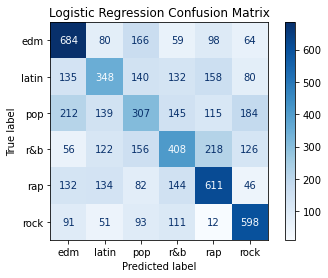

In [80]:
from sklearn.metrics import plot_confusion_matrix 
plot_confusion_matrix(clf, X_test_scaled, y_test, cmap = plt.cm.Blues, display_labels= list_genres)
plt.title("Logistic Regression Confusion Matrix")
plt.show()

In [81]:
print(classification_report(y_test, y_pred_clf))

              precision    recall  f1-score   support

           0       0.52      0.59      0.56      1151
           1       0.40      0.35      0.37       993
           2       0.33      0.28      0.30      1102
           3       0.41      0.38      0.39      1086
           4       0.50      0.53      0.52      1149
           5       0.54      0.63      0.58       956

    accuracy                           0.46      6437
   macro avg       0.45      0.46      0.45      6437
weighted avg       0.45      0.46      0.45      6437



### Logistic Regression Performance Analysis:

- According to the confusion matrix, we see that the best predictions are done for "edm", "rap" then "rock" musics. The worst genres predictions are for "pop", "latin" and "r&nb". 

- The classfication report show the same results with a better recall for edm (0), rap (4) and rock (5).

- This is similar to what we expected from our data analysis part, with the lowest correlations between these features and these genres classes.

- The logistic regression model we have evaluated with this dataset and this feature engineering is neither really satisfactory nor usable for classfications in the music industry. It looks that the model struggles figuring out the differences between some classes with less possibilities to distinguish with the given features. 


In [82]:
# summarize feature importance

clf_importance = pd.DataFrame(clf.coef_, columns= features.columns, index= list_genres)
clf_importance

,track_popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,top_20
edm,-0.219833,0.399987,0.473588,-0.000712,0.366993,-0.102785,-0.037583,-0.227369,0.492656,0.086464,-0.649103,0.201059,-0.194939,-0.002102
latin,0.063166,0.475556,0.096886,0.024019,0.105288,0.014991,0.099972,0.278347,-0.057720,-0.004623,0.211841,-0.004443,-0.091792,0.021158
pop,0.166891,-0.138646,-0.108373,-0.012175,0.146118,0.037796,-0.379192,-0.040923,0.016754,-0.087014,-0.019453,0.010427,-0.137295,0.034751
r&b,-0.117913,0.015092,-0.765713,0.009563,0.004302,-0.086655,0.371663,0.081203,-0.415887,-0.008688,0.194746,-0.161092,0.258498,0.112604
rap,-0.069908,0.566544,-0.365289,0.000621,0.120153,-0.078521,0.907674,-0.019450,0.167244,0.062906,-0.267660,0.019631,-0.140592,0.041583
rock,0.177598,-1.318534,0.668901,-0.021315,-0.742855,0.215175,-0.962534,-0.071808,-0.203048,-0.049045,0.529629,-0.065583,0.306121,-0.207993


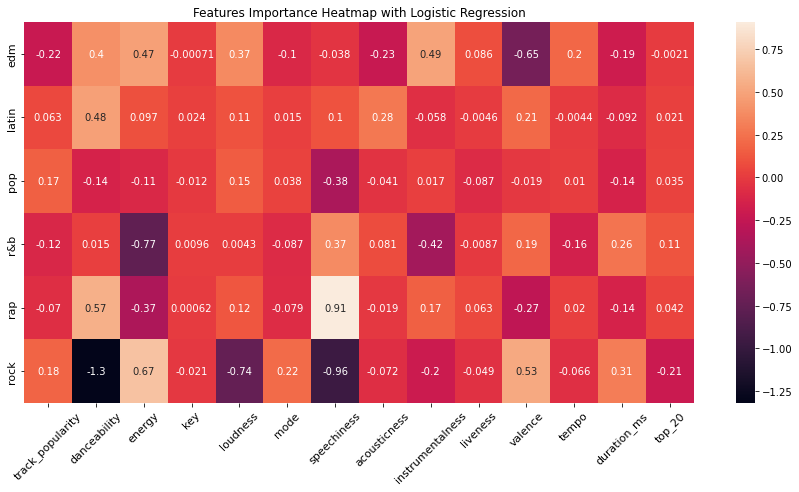

In [83]:
fig, ax = plt.subplots(figsize=(15,7)) 
sns.heatmap(clf_importance, annot= True)
plt.xticks(rotation = 45, size=11)
plt.yticks(size=11)
plt.title("Features Importance Heatmap with Logistic Regression")
plt.show()

### Features Importance analysis with Logistic Regression :

- The genres that showed better predictability results have features with strong importance (either positive or negative impacts) :
    - rock is highly negatively impacted by 3 features : danceability, speechiness and loudness
    - rap is highly positively impacted by speechiness (0.91)
    - edm is highly negatively impacted by valence (-0.65)
    
- R&nb is negatively impacted by energy. But the logistic regression wasn't able to predict this genre class well, which at this stage we cannot explain.
- The other 2 classes (pop and latin) are not having any impactful features, which explains why the model struggles to predict these classes.


<h3> 2. Random Forest Regression:</h3>

In [84]:
rf =RandomForestClassifier(random_state=42)
rf.fit(X_train, y_train)

RandomForestClassifier(random_state=42)

In [85]:
y_pred_rf = rf.predict(X_test)

In [86]:
print("first five predicted values:", y_pred_rf[0:5])
print("first five actual values:", list(y_test[0:5]))

first five predicted values: [5 4 3 4 5]
first five actual values: [3, 3, 3, 0, 5]


### Evaluate the performance of the model on the test set:

In [87]:
# visualizing Random forest test performance metrics as a dataframe

measures =[round(accuracy_score(y_test, y_pred_rf), 2), round(recall_score(y_test, y_pred_rf, average = 'macro'), 2), round(precision_score(y_test, y_pred_rf, average = 'macro'), 2),round(f1_score(y_test, y_pred_rf, average = 'macro'), 2) ]

df_rf_test = pd.DataFrame({'Random Forest': measures},index=['accuracy','recall','precision', 'f1-score'])
df_rf_test

,Random Forest
accuracy,0.55
recall,0.55
precision,0.55
f1-score,0.55


The Random Forest model's performance on all scores is better (0.55 Vs 0.45 and 0.46) than the logistic regression. The overall performance is above the threshold of 0.5 but is still not great.

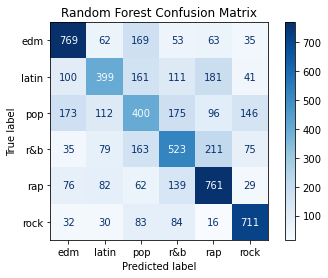

In [88]:
plot_confusion_matrix(rf, X_test, y_test, cmap = plt.cm.Blues, display_labels= list_genres)
plt.title('Random Forest Confusion Matrix')
plt.show()

In [89]:
print(classification_report(y_test, y_pred_rf))

              precision    recall  f1-score   support

           0       0.65      0.67      0.66      1151
           1       0.52      0.40      0.45       993
           2       0.39      0.36      0.37      1102
           3       0.48      0.48      0.48      1086
           4       0.57      0.66      0.61      1149
           5       0.69      0.74      0.71       956

    accuracy                           0.55      6437
   macro avg       0.55      0.55      0.55      6437
weighted avg       0.55      0.55      0.55      6437



- There are still the 3 same genres that are accurately predicted by the model : edm, rap and rock. 
- r&nb is performing better with better accurate predictions Versus with logistic regression model
- pop's predictability has also improved significantly. So for pop, random forest is a better model choice. But pop and latin are hard to predict.

These results are corroborated by the classification report here above, showing that the recall and precision are improved Versus with the logistic regression.
Rock is well predicted by the random forest model with 74% recall and 69% precision.
Pop is difficult to predict as most of the time is a misclassified into another class (False negative).

In [90]:
rf_importances = pd.DataFrame(rf.feature_importances_, index= features.columns, columns= ["feature_importances"]).sort_values("feature_importances", ascending= 0)
rf_importances

,feature_importances
speechiness,0.110276
tempo,0.110031
danceability,0.105100
energy,0.090048
duration_ms,0.084203
acousticness,0.083162
valence,0.083074
loudness,0.079563
track_popularity,0.069879
instrumentalness,0.069095


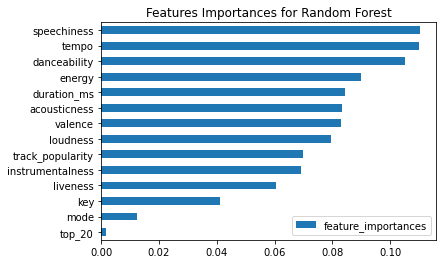

In [91]:
rf_importances.sort_values(by='feature_importances').plot(kind='barh')
plt.title("Features Importances for Random Forest")
plt.show()

The most important features for the random forest are speechiness, tempo, danceability and energy. These features with high feature importance are able to remove more impurity than the others. Looking back at our data exploration this makes sense as these features were partially unique to a certain genre and thus have a big importance for their classification. For example, speechiness is an almost exclusive feature for rap music, or low danceability is important to classify rock music.

Surprisingly, duration seems to be an important feature for the random forest, although during data exploration, it showed little variance between the different genres. 

The top20 artists is the least important feature for the random forest model.

<h3> 3. XG Boosting model : </h3>

In [92]:
xgb = XGBClassifier()
xgb.fit(X_train, y_train)

XGBClassifier(base_score=0.5, booster='gbtree', callbacks=None,
              colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',
              importance_type=None, interaction_constraints='',
              learning_rate=0.300000012, max_bin=256, max_cat_to_onehot=4,
              max_delta_step=0, max_depth=6, max_leaves=0, min_child_weight=1,
              missing=nan, monotone_constraints='()', n_estimators=100,
              n_jobs=0, num_parallel_tree=1, objective='multi:softprob',
              predictor='auto', random_state=0, reg_alpha=0, ...)

In [93]:
y_pred_xgb = xgb.predict(X_test)

In [94]:
print("first five predicted values:", y_pred_xgb[0:5])
print("first five actual values:", list(y_test[0:5]))

first five predicted values: [5 4 3 4 5]
first five actual values: [3, 3, 3, 0, 5]


### Evaluate the performance of the model on the test set:

In [95]:
# visualizing XG Boost test performance metrics as a dataframe

measures =[round(accuracy_score(y_test, y_pred_xgb), 2), round(recall_score(y_test, y_pred_xgb, average = 'macro'), 2), round(precision_score(y_test, y_pred_xgb, average = 'macro'), 2),round(f1_score(y_test, y_pred_xgb, average = 'macro'), 2) ]

df_xgb_test = pd.DataFrame({'XGBoost': measures},index=['accuracy','recall','precision', 'f1-score'])
df_xgb_test

,XGBoost
accuracy,0.56
recall,0.56
precision,0.56
f1-score,0.56


- XGBoost has the best performance scores compared to Logistic Regression and to Random Forest. 
- But it is very close to the Random Forest scores (0.56 Vs 0.55 over all scores). 

It looks like the best performing model. But let's have a look at the genre predictions to discriminate between both models (Random Forest and XGBoost).

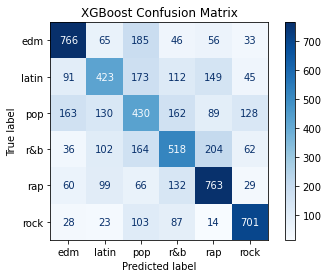

In [96]:
plot_confusion_matrix(xgb, X_test, y_test, cmap = plt.cm.Blues, display_labels= list_genres)
plt.title('XGBoost Confusion Matrix')
plt.show()

In [97]:
print(classification_report(y_test, y_pred_xgb))

              precision    recall  f1-score   support

           0       0.67      0.67      0.67      1151
           1       0.50      0.43      0.46       993
           2       0.38      0.39      0.39      1102
           3       0.49      0.48      0.48      1086
           4       0.60      0.66      0.63      1149
           5       0.70      0.73      0.72       956

    accuracy                           0.56      6437
   macro avg       0.56      0.56      0.56      6437
weighted avg       0.56      0.56      0.56      6437



- XGBoost has better predictions on pop and latin than both other models
- XGBoost has a better precision over all classes
- Recall is almost better for all classes, except for rock where is 1% worse (0.73 Vs 0.74) and the same for rap with a recall of 0.66 and edm with a recall of 0.67.

The classification report confirms that XGBoost is the best model for genre classification with ML : 
- It has a **better precision** and enables a better **class discrimination with fewer false positives**
- It performs similarly to random forest for recalls.

In [98]:
xgb_importances = pd.DataFrame(xgb.feature_importances_, index= features.columns, columns= ["feature_importances"]).sort_values("feature_importances", ascending= 0)
xgb_importances

,feature_importances
speechiness,0.127516
tempo,0.113823
danceability,0.110812
energy,0.090977
instrumentalness,0.081272
valence,0.074718
duration_ms,0.067321
loudness,0.057755
acousticness,0.056388
track_popularity,0.053446


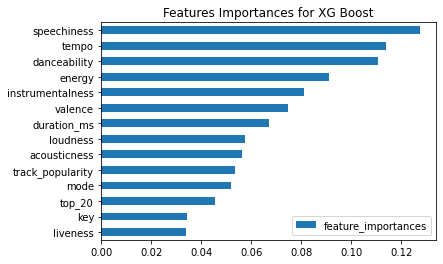

In [99]:
xgb_importances.sort_values(by='feature_importances').plot(kind='barh')
plt.title("Features Importances for XG Boost")
plt.show()

Interestingly the importance of the features has changed. The 4 most important features are the same as with the random forest model (speechiness, tempo, danceability and energy). But the order of importance has changed for the remaining features. 

With XGBoost, we can observe a **clearer hierarchy between the features.** than with Random Forest. So we can say that this model has learned the feature importance in the genre classification.
And no features are less important than 0.03 compared to Random Forest.

<h3>ML Modeling summary - Comparing the models' test performances :</h3>

In [100]:
#creating a dataframe to compare all models' performances :

df_performance = df_clf_test.join(df_rf_test)
df_performance = df_performance.join(df_xgb_test)
df_performance #viewing the test performance dataframe

,Logistic Regression,Random Forest,XGBoost
accuracy,0.46,0.55,0.56
recall,0.46,0.55,0.56
precision,0.45,0.55,0.56
f1-score,0.45,0.55,0.56


In this Dataframe, we summarised the key metrics for all 3 models that we have build.

As our best model, we selected the `XG Boost`, we believe that this model predicts the *genre* of the songs the best.

<h2> V. Evaluate the selected model: XG Boost </h2>

### Plot the Learning Curve:

Using learning_curve_plot function to plot the learning curve:

In [101]:
def learning_curve_plot(model, X_train, y_train, scoring):
    plt.figure(figsize=(5, 5)) # set figure size
    train_sizes, train_scores, test_scores = learning_curve(model,
                                                            X_train,
                                                            y_train,
                                                            cv = 5, # Number of folds in cross-validation
                                                            scoring = scoring,# Evaluation metric
                                                            n_jobs = -1,# Use all computer cores
                                                            shuffle = True,
                                                            train_sizes = np.linspace(0.01, 1.0, 5)) # 5 different sizes of the training set
    # Create means and standard deviations of training set scores
    train_mean = np.mean(train_scores, axis = 1)
    train_std = np.std(train_scores, axis = 1)

    # Create means and standard deviations of test set scores
    test_mean = np.mean(test_scores, axis = 1)
    test_std = np.std(test_scores, axis = 1)

    # Draw lines
    plt.plot(train_sizes, train_mean, '--', color = "#111111", label = "Training score")
    plt.plot(train_sizes, test_mean, color = "#111111", label = "Cross-validation score")

    # Draw bands
    plt.fill_between(train_sizes, train_mean - train_std, train_mean + train_std, color = "#DDDDDD")
    plt.fill_between(train_sizes, test_mean - test_std, test_mean + test_std, color = "#DDDDDD")

    # Create plot
    plt.title(f"Learning Curves (scoring = {scoring})")
    plt.xlabel("Training Set Size"), plt.ylabel("Score"), plt.legend(loc = "best")
    plt.tight_layout()
    
    
    plt.show()

In [105]:
joblib.dump(xgb, "test.pkl")

['test.pkl']

In [102]:
from sklearn.model_selection import learning_curve

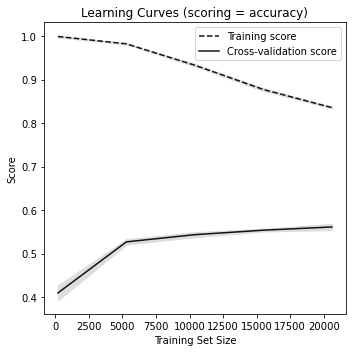

In [103]:
learning_curve_plot(xgb, X_train, y_train, scoring = 'accuracy')

### Model limitations :

Our best model is performing better in the training set and worse on the validation set, with a high variance. 
**Our model is overfitting.**
To control overfitting, we have 2 possibilities to make a model more generalized:
* We could control the model complexity through hyperparameters tuning, such as `max_depth`, `min_child_weight` and `gamma`
* Add randomness to make the model less sensitive to noise, such as `subsample`and `colsample_bytry`.

We have also had a time constraint of 48 hours to work on the EDA and ML models. We would need more time in order to improve the feature engineering step as well as tune our models with hyperparameters.

<h2> VI. Conclusion :</h2>

![https://www.memecreator.org/static/images/memes/4799759.jpg](https://www.memecreator.org/static/images/memes/4799759.jpg)

💡 In conclusion, we create a `XGBoost` multi-class classifier model with mediocre accuracy of 0.56. The model is *not* the solution for the company yet. However, with limited time and resources there are some possibilities for optimization which the team did not explore yet. With right hyperparameter tuning and more data the model performance should improve. 

As of now, the model is better at predicting certain genres over others. The model is performing particularly bad on pop, latin and r&b which re-enforced our finding during data exploration.

✅ During our data exploration we found certain differences between genres. Some of the genres had quite distinct features, which includes edm, rap and rock. These genres have one or more features that help to clearly distinguish them from other genres. This makes sense as these genres have unique musical properties, for example rap consisting mainly of spoken words or edm being very instrumental in contrast to other genres. 

❌ On the other hand we found the genres pop, latin and r&b less easy to tell apart from just looking at the feature distribution. They stand out only slightly for several features but have less genre-unique characteristics. It makes sense, as especially pop is considered a generic music genre and shows little uniqueness.

🏆 We believe that speechiness, tempo, danceability and energy are the most important features to predict the target.

Lastly, we evaluate our chosen model `XGBoost`

##### *Pros* of out best model:
* have better precision for all classes
* able to better distinguish between latin and pop 
* fast training time
* feature important has clear hierarchy
* less features engineering
* less sensitivity to outliers
  
##### *Cons* of our best model: 
* prone to overfitting without hyperparameter tuning
* hard to tune hyperparameter
* less explainability